# Week 4: Flow Estimation

If you are running on Colab,
* Go to runtime -> change runtime type -> select "GPU" as the hardware accelerator. 

## Having Fun with Optical Flow

### ARFlow

Download the code for ARFlow from this link and install the requirements as recommended: https://github.com/lliuz/ARFlow

Make sure that you can run the inference.py without a problem before the next part.

If you could not install ARFlow on your local machine, you can follow these steps either on Colab or on your own machine to make it work:

Download the repository:

In [ ]:
!wget https://github.com/lliuz/ARFlow/archive/master.zip

Unzip the repository:

In [ ]:
!unzip master.zip

Archive:  master.zip
e92a8bbe66f0ced244267f43e3e55ad0fe46ff3e
replace ARFlow-master/.gitignore? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

Navigate to the repository:

In [2]:
cd ARFlow-master/

/content/ARFlow-master


From the menu on the left, open `models/pwclite.py` file, comment the 6th line and uncomment the 7th line.
Then, **if you are using Colab you should not run the next cell**. but if you are on your local machine, install the requirements:

In [ ]:
# !pip3 install -r requirements.txt

Now you should be able to run the following:

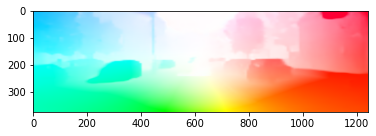

In [3]:
%run inference.py -m checkpoints/KITTI15/pwclite_ar.tar -s 384 640  -i examples/img1.png examples/img2.png

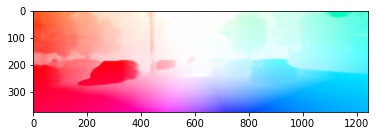

In [4]:
from inference import TestHelper

img_list = ['examples/img2.png', 'examples/img1.png']
cfg = {
    'model': {
        'upsample': True,
        'n_frames': len(args.img_list),
        'reduce_dense': True
    },
    'pretrained_model': 'checkpoints/KITTI15/pwclite_ar.tar',
    'test_shape': (384, 640),
}

ts = TestHelper(cfg)

imgs = [imageio.imread(img).astype(np.float32) for img in img_list]
h, w = imgs[0].shape[:2]

flow_12 = ts.run(imgs)['flows_fw'][0]

flow_12 = resize_flow(flow_12, (h, w))
np_flow_12 = flow_12[0].detach().cpu().numpy().transpose([1, 2, 0])

vis_flow = flow_to_image(np_flow_12)

fig = plt.figure()
plt.imshow(vis_flow)
plt.show()

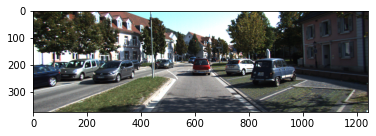

In [5]:
plt.imshow(imgs[0].astype(np.uint8))

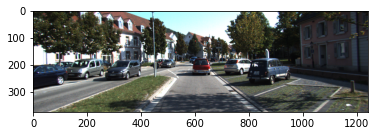

In [6]:
plt.imshow(imgs[1].astype(np.uint8))

In [7]:
from utils.warp_utils import flow_warp
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')

fig = plt.figure(figsize=(8,3))
plt.axis(False)
x = torch.tensor(imgs[0]).transpose(2, 0).transpose(2, 1).unsqueeze(0).to('cuda')
img = plt.imshow(imgs[0].astype(np.uint8), animated=True)

step = 0
def interpolate_next(*args):
  global step
  step += 0.1
  inter_img = flow_warp(x, flow_12*step).cpu().detach().numpy()[0].transpose(1, 2, 0).astype(np.uint8)
  
  img.set_array(inter_img)
  return img,
plt.close()
animation.FuncAnimation(fig, interpolate_next, frames=10, blit=True, repeat=True)

### Bullet Time Effect

In this question, you will estimate optical flow using ARFlow (or you can use some other flow method if you cannot make it work) and then use it to interpolate between two images. 

First, calculate the optical flow between two images, e.g. provided KITTI images in the example folder, using the ARFlow as illustrated by the example in inference.py. 
Then, synthesize 10 novel frames between the two images using linear interpolation. 

**Hint:** First, compute the flow and then divide it by the number of frames. Then, at each step, warp the image incrementally to obtain images in between. You can use OpenCV's `remap()` function for warping or have a look at the `flow_warp` in utils/warp_utils.py file of the ARFlow.

* Where does the interpolation work well and where does it fail? 

**Answer**: Looking at the last interpolated frame, we can see that if the relative speed between objects is small (e.g., parked cars), the interpolation works very well. However, for high relative speeds we see a significant distortion (e.g., the other lane car).

* Please also hand-in your interpolated images or create a small movie.


### Multi-frame Bullet Time Sequence (Optional)

If you had fun with the previous question, you might want to extend this effect to several frames as in the original Matrix movie! 

Use consecutive images from last week's sequence or capture several images along a smooth camera trajectory and smoothly vary the pose of the objects in between. 

Between each two adjacent frames, interpolate an additional 10 to 100 frames and concatenate all images to one long slow motion video sequence.

In [8]:
# installing youtube-dl 
!sudo curl -L https://yt-dl.org/downloads/latest/youtube-dl -o /usr/local/bin/youtube-dl
!sudo chmod a+rx /usr/local/bin/youtube-dl 

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     3    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0     3    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100   614  100   614    0     0    627      0 --:--:-- --:--:-- --:--:--   627
100 1781k  100 1781k    0     0  1384k      0  0:00:01  0:00:01 --:--:-- 6959k


In [9]:
# dowloading a video with youtube-dl
!youtube-dl kHBcVlqpvZ8 --merge-output-format mp4 

[youtube] kHBcVlqpvZ8: Downloading webpage
[download] UpTown Spot-kHBcVlqpvZ8.mp4 has already been downloaded and merged


In [10]:
import numpy as np
import cv2

cap = cv2.VideoCapture('UpTown Spot-kHBcVlqpvZ8.mp4')
imgs = []
for i in range(300):
    ret, frame = cap.read()
    if i > 200 and i % 3 == 0: # deviding fps by 3
      frame = cv2.resize(frame, (640, 480))
      rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
      imgs.append(rgb)

cap.release()

In [11]:
fig = plt.figure(figsize=(4,3))
plt.axis(False)
img = plt.imshow(imgs[0], animated=True)

step = 0
def animate_imgs(*args):
  global step
  img.set_array(imgs[step])
  step += 1
  return img
plt.close()
# since fps = 30, interval = 1000 / 30 ms
animation.FuncAnimation(fig, animate_imgs, frames=len(imgs)-2, interval=100)

In [12]:
# Let's interpolate from 10 fps to 60 fps
interpolated_imgs = []
h, w = imgs[0].shape[:2]
prev_img = imgs[0]
for img in imgs:

  img_pair = [img.astype(np.float32), prev_img.astype(np.float32)]
  flow_12 = ts.run(img_pair)['flows_fw'][0]

  flow_12 = resize_flow(flow_12, (h, w))
  np_flow_12 = flow_12[0].detach().cpu().numpy().transpose([1, 2, 0])

  x = torch.tensor(img).transpose(2, 0).transpose(2, 1).unsqueeze(0).to('cuda').float()
  for step in np.linspace(0, 1, 6):
    inter_img = flow_warp(x, flow_12*step).cpu().detach().numpy()[0].transpose(1, 2, 0).astype(np.uint8)
    interpolated_imgs.append(inter_img)

  prev_img = img

In [13]:
fig = plt.figure(figsize=(4,3))
plt.axis(False)
img = plt.imshow(imgs[0], animated=True)

step = 0
def animate_imgs(*args):
  global step
  img.set_array(interpolated_imgs[step])
  step += 1
  return img
plt.close()

animation.FuncAnimation(fig, animate_imgs, frames=len(interpolated_imgs)-2, interval=1000/60)